# *Traffic Sign Detection and Recognition*
#### Rafael Andrade da Silva

Este trabalho tem como objetivo construir um dataset composto por placas de regulamentação de trânsito utilizadas no Brasil, e desenvolver um modelo capaz de detectar e reconhecer estas placas com uma boa acurácia. 

Segundo o manual Sinalização Vertical de Regulamentação, disponível em https://infraestrutura.gov.br/images/Resolucoes/Manual_VOL_I_2.pdf , do Conselho Nacional de Trânsito (CONTRAN), existem 51 itens de sinalização vertical de regulamentação, cujo objetivo é informar aos usuários (pedestres, motoristas, ciclistas) sobre as obrigações ou proibições no uso das vias urbanas ou rurais.


Installing modules and libraries

In [ ]:
!pip install scipy
!pip install imgaug==0.2.6
!pip install -q keras
!pip install -q tqdm
!apt-get -qq install -y libsm6 libxext6 && pip install -q -U opencv-python
!apt-get install -y -qq software-properties-common python-software-properties module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse
!pip install -q tensorflow-model-optimization
!apt-get -qq install xxd
!pip install -U keras-tuner

E: Package 'python-software-properties' has no installation candidate
Requirement already up-to-date: keras-tuner in /usr/local/lib/python3.7/dist-packages (1.0.2)


Importing data to work with Keras and Google Drive inside COLAB

In [ ]:
import tensorflow as tf
print('Tensor Flor Version: ', tf.__version__)

Tensor Flor Version:  2.4.1


Authenticating and granting permissions to access Google Drive, where the training data is located and where the models will be saved.

In [ ]:
from google.colab import auth
auth.authenticate_user()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Mounting the drive

In [ ]:
!mkdir -p drive
!google-drive-ocamlfuse drive

drive.mount('/content/drive')
root_path = 'drive/My\ Drive/Colab\ Notebooks'

/usr/bin/xdg-open: 851: /usr/bin/xdg-open: www-browser: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: links2: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: elinks: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: links: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: lynx: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: w3m: not found
xdg-open: no method available for opening 'https://accounts.google.com/o/oauth2/auth?client_id=564921029129.apps.googleusercontent.com&redirect_uri=https%3A%2F%2Fgd-ocaml-auth.appspot.com%2Foauth2callback&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&response_type=code&access_type=offline&approval_prompt=force&state=oeslFnBadl5QBL-Udj8BsqPTBXJkXXla%2FoLIjBL2Ty4'
/bin/sh: 1: firefox: not found
/bin/sh: 1: google-chrome: not found
/bin/sh: 1: chromium-browser: not found
/bin/sh: 1: open: not found
Cannot retrieve auth tokens.
Failure("Error opening URL:https://accounts.google.com/o/oauth2/auth?client_id=564921029129.apps.

Importing the libraries

In [ ]:
import numpy as np
import time, math
import datetime, os
import matplotlib.pyplot as plt
import seaborn as sns
#import os
import io
import sys
#import numpy as np
import pandas as pd
import imageio as im
import glob
import tensorflow_model_optimization as tfmot
import IPython
import kerastuner as kt

from kerastuner.tuners import RandomSearch
from tqdm import tqdm_notebook as tqdm
from six.moves import cPickle
from keras.utils import np_utils
from keras import backend as K
from tensorflow.keras import datasets, layers, models, regularizers
#from tensorflow.keras.optimizers import SGD
from tensorflow.keras.utils import plot_model, to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from IPython.display import Image
from collections import Counter
from sklearn.metrics import confusion_matrix
from keras.callbacks import LearningRateScheduler

Verifying that fast execution is enabled.

* Excerpt from official documentation:

[...] TensorFlow's eager execution is an imperative programming environment that evaluates operations immediately, without building graphs: operations return concrete values instead of constructing a computational graph to run later. This makes it easy to get started with TensorFlow and debug models, and it reduces boilerplate as well. To follow along with this guide, run the code samples below in an interactive python interpreter.



In [ ]:
tf.executing_eagerly()

True

Loading the Tensorboard

In [ ]:
%load_ext tensorboard

Checking for GPUs

In [ ]:
print (tf.test.gpu_device_name())

/device:GPU:0


### Load Dataset Parameters

CHUNK_SIZE: number of items in each training lot;

BATCHS_QUANTITY: number of batch files for training;

NUM_TRAIN_SAMPLES: total amount of images for training;

NUM_TEST_SAMPLES: total amount of images for testing;

In [ ]:
CHUNK_SIZE =  1436#@param {type:"integer"}
BATCHS_QUANTITY =  9#@param {type:"integer"}
NUM_TRAIN_SAMPLES = 12071 #@param {type:"integer"}
NUM_VALID_SAMPLES = 6015 #@param {type:"integer"}
NUM_TEST_SAMPLES = 5986 #@param {type:"integer"}

Importing the dataset pieces

In [ ]:
import pickle

def load_data_own():
    import os
    import sys
    from six.moves import cPickle
    import numpy as np
    
    def load_batch(fpath):
        with open(fpath, 'rb') as f:
            d = pickle.load(f) 

        data = [item[1:] for item in d]
        labels = [item[0] for item in d]
        data = np.asarray(data)
        labels = np.asarray(labels)
        data = data.reshape(data.shape[0], 3, 32, 32)
        return data, labels

    
    
    path = '/content/drive/My Drive/Colab Notebooks/CIARP'
    #path = root_path + '/CIARP'

    x_train = np.empty((NUM_TRAIN_SAMPLES, 3, 32, 32), dtype='uint8')
    y_train = np.empty((NUM_TRAIN_SAMPLES,), dtype='uint8')
    
    x_valid = np.empty((NUM_VALID_SAMPLES, 3, 32, 32), dtype='uint8')
    y_valid = np.empty((NUM_VALID_SAMPLES,), dtype='uint8')

    x_test = np.empty((NUM_TEST_SAMPLES, 3, 32, 32), dtype='uint8')
    y_test = np.empty((NUM_TEST_SAMPLES,), dtype='uint8')

    fpath = os.path.join(path, 'training_unique_batch')
    x_train, y_train = load_batch(fpath)

    fpath = os.path.join(path, 'validation_batch')
    x_valid, y_valid = load_batch(fpath)

    fpath = os.path.join(path, 'testing_batch')
    x_test, y_test = load_batch(fpath)

    y_train = np.reshape(y_train, (len(y_train), 1))
    y_test = np.reshape(y_test, (len(y_test), 1))
    y_valid = np.reshape(y_valid, (len(y_valid), 1))

    x_train = x_train.transpose(0, 2, 3, 1)
    x_test = x_test.transpose(0, 2, 3, 1)
    x_valid = x_valid.transpose(0, 2, 3, 1)

    #SAVE THE DATA TO A NP ARRAY
    np.save(path + 'x_test_mestrado.npy', x_test)
    np.save(path + 'y_test_mestrado.npy', y_test)
    np.save(path + 'x_train_mestrado.npy', x_train)
    np.save(path + 'y_train_mestrado.npy', y_train)
    np.save(path + 'x_valid_mestrado.npy', x_valid)
    np.save(path + 'y_valid_mestrado.npy', y_valid)


    return (x_train, y_train), (x_valid, y_valid), (x_test, y_test)

#### DATASET

Until the beginning of the coding of this notebook, no dataset was found composed of Brazilian traffic signs. With that, a hard work was started to compose a valid dataset for tests with the proposed model. All items of vertical, horizontal, traffic light, works or auxiliary devices are distributed in seven volumes, and as it should have been clear, it is an extensive set, and it would take some time for it to be completely mapped. Thus, in this initial moment, the aim was only to build the data set with the vertical regulatory signposts, composed of 51 items. The aim of the dataset coding was to set up a base similar to the CIFAR-10 data set, thus facilitating the implementation of the model, since one could test the set using already well-defined models.

The images used to compose the initial base were taken from Google Street View images, footage taken with cell phones in local traffic and photos downloaded from Google Images.

In the figure below we can see in the first column the nomenclature originally used by CONTRAN to classify the regulatory plates. The second column was the nomenclature used in the work. The change was necessary to reduce the size of the class identification so that it would fit in 1 byte, as used in the CIFAR10 dataset.

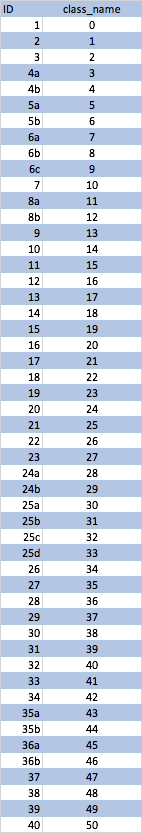



The various figures used to assemble the dataset were downloaded from the internet or obtained through recordings from mobile devices. Therefore, it was necessary to pre-process these files. For this, we developed a python script that, after the operations described in the flowchart below, returned only the area of the image referring to a traffic sign.

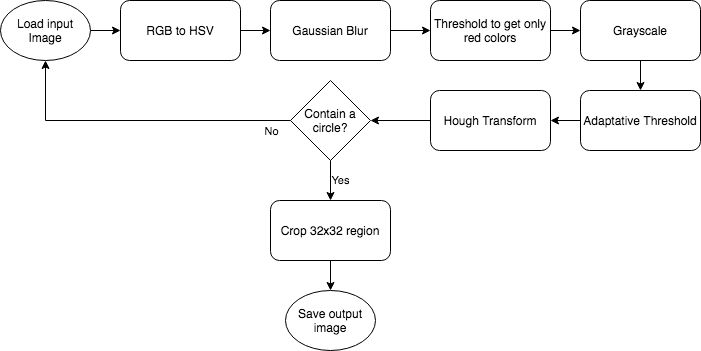



Below we can see an image used as input ...

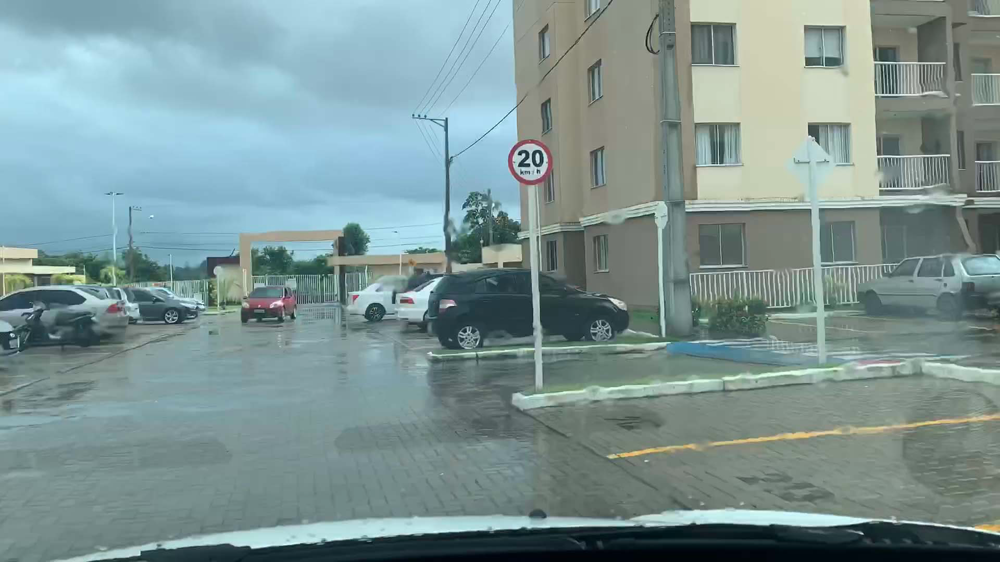

... and then a summary of the operations performed on it and the result, a plaque cut from the original figure.

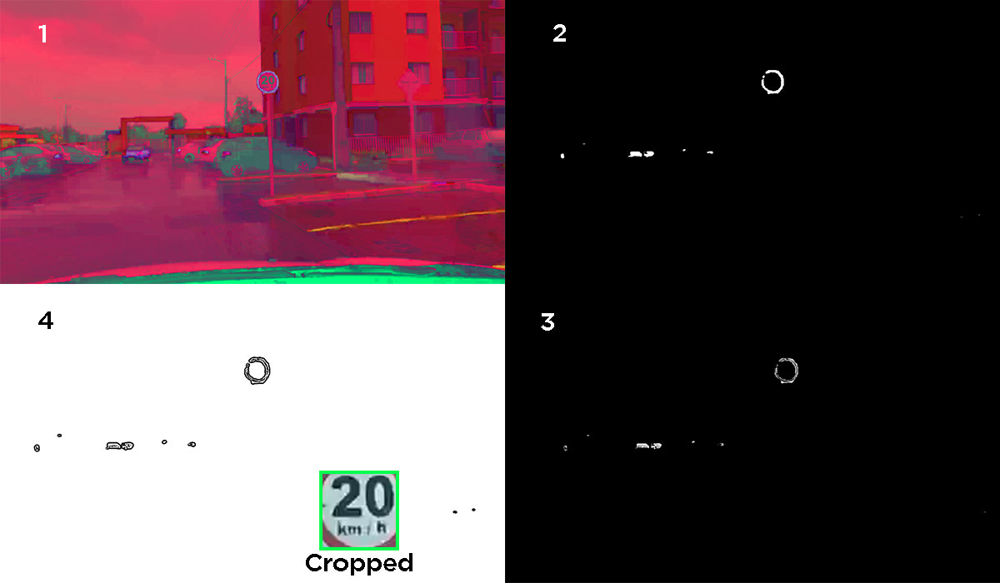

Loading and verifying the size of training, validation and testing parts.

In [ ]:
(train_images, train_labels), (valid_images, valid_labels) , (test_images, test_labels) = load_data_own()

print(len(train_images))
print(len(valid_images))
print(len(test_images))

12071
6015
5986


Verifying the training dataset balance

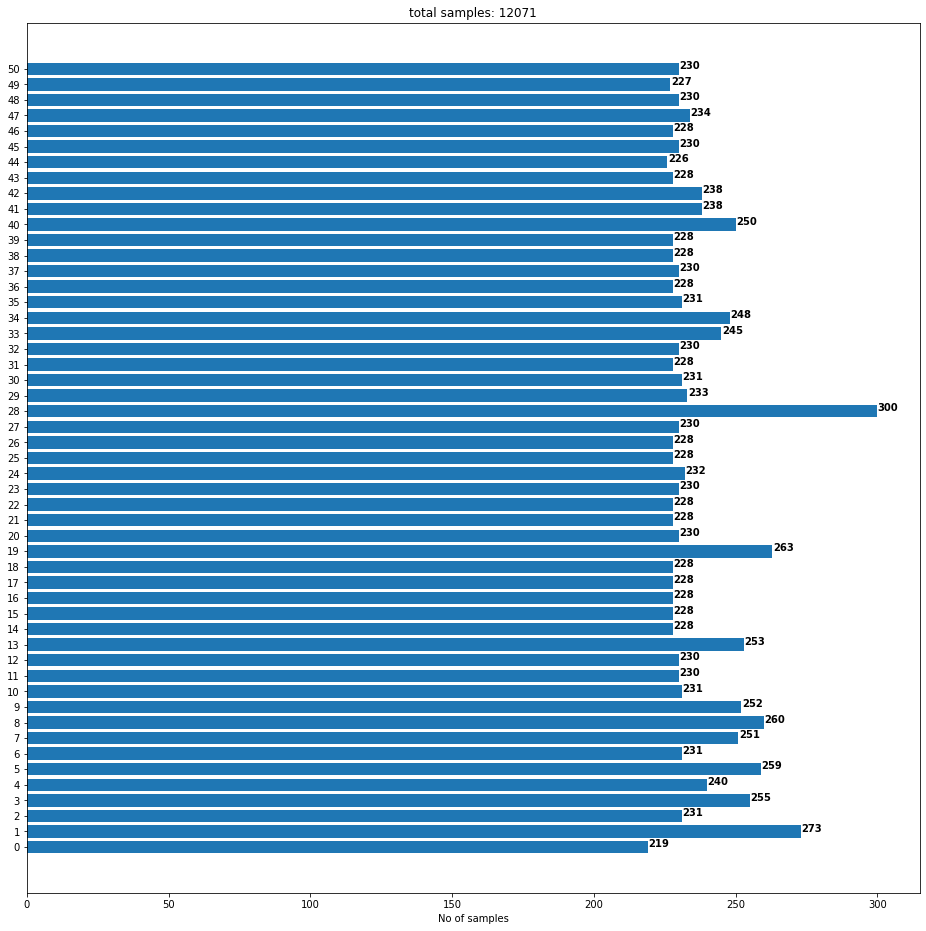

In [ ]:
labels = []
numbers = []
indices_placas = []
total = 0

for i in range(NUM_TRAIN_SAMPLES):
    aux = train_labels[i][0]
    indices_placas.append(aux)

#print(indices_placas)
z = Counter(indices_placas)

for key, value in z.items():
    labels.append(key)
    numbers.append(value)
    total += value

index = np.arange(len(labels))

plt.figure(figsize=(16,16))
plt.barh(index, numbers)
for i, v in enumerate(numbers):
    plt.text(v + 0.2, i, str(v), color='black', fontweight='bold')
plt.yticks(index, labels, fontsize=10, rotation=0)
plt.xlabel('No of samples', fontsize=10)
plt.title("total samples: {}".format(total))
plt.show()



As the data set was created manually, there could be some plate sequences in the images. Therefore, a shuffle is applied to the images before using them in training.

Training Set Samples


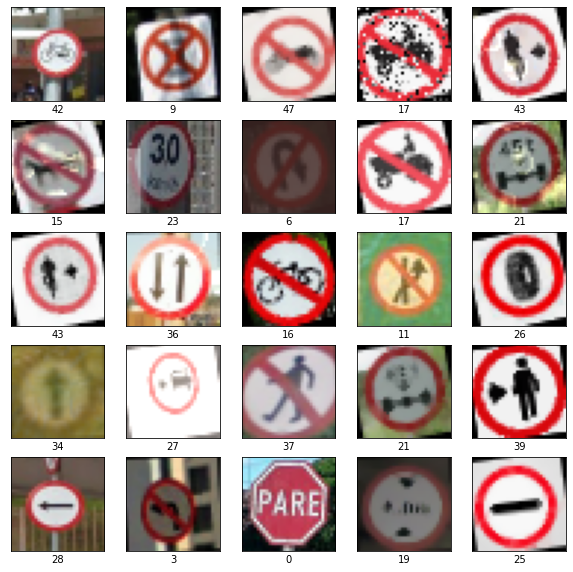

Validation Set Samples


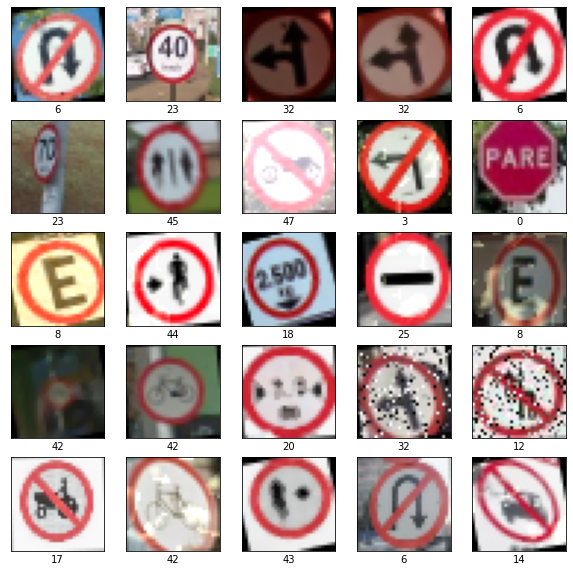

Test Set Samples


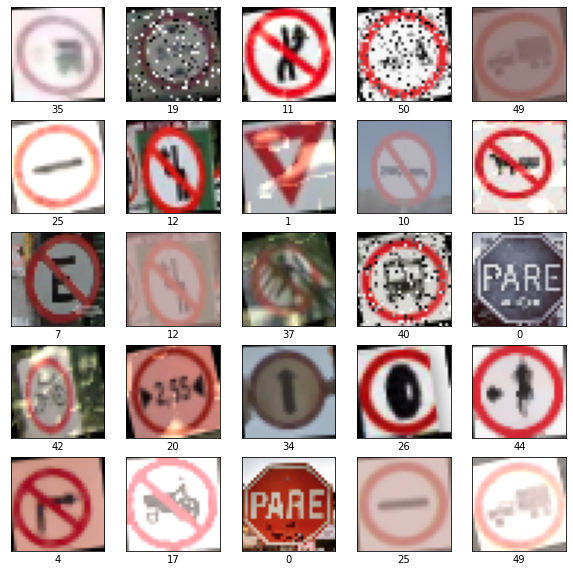

In [ ]:


shuffle_index = np.random.permutation(NUM_TRAIN_SAMPLES)
train_images, train_labels = train_images[shuffle_index], train_labels[shuffle_index]

shuffle_index = np.random.permutation(NUM_VALID_SAMPLES)
valid_images, valid_labels = valid_images[shuffle_index], valid_labels[shuffle_index]

shuffle_index = np.random.permutation(NUM_TEST_SAMPLES)
test_images, test_labels = test_images[shuffle_index], test_labels[shuffle_index]

print('Training Set Samples')
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(train_images[i], cmap=plt.cm.binary)
    plt.xlabel(train_labels[i][0])
    #plt.xlabel(class_names[train_labels[i][0]])
plt.show()


print('Validation Set Samples')
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(valid_images[i], cmap=plt.cm.binary)
    plt.xlabel(valid_labels[i][0])
    #plt.xlabel(class_names[train_labels[i][0]])
plt.show()

print('Test Set Samples')
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(test_images[i], cmap=plt.cm.binary)
    plt.xlabel(test_labels[i][0])
    #plt.xlabel(class_names[train_labels[i][0]])
plt.show()

### **Normalização dos dados**

Inicialmente, utilizou-se a abordagem padrão, discutida na documantação do TensorFlow:

**train_images, test_images = train_images / 255.0, test_images / 255.0**

O trecho acima basicamente normaliza os valores RGB de cada imagem do conjunto, dividindo-os por 255.

Depois da leitura do livro **Introdução a mineração de dados**, de Ferrari e Castro Silva, optou-se pelo uso da nomralização *Z-Score*, pois se mostra útil quando valores máximos e mínimos de um atributo não são conhecidos, ou quando há *outliers*. Um valor *v* de *A* é normalizado através da seguinte fórmula.

\begin{align}
\dot{v} & = (v - mean_A) / stddev_A
\end{align}

In [ ]:
train_images = train_images - np.mean(train_images) / (train_images.std() + 1e-7)
test_images = test_images - np.mean(test_images) / (test_images.std() + 1e-7)

#train_images = train_images / 255.0
#test_images = test_images / 255.0
#valid_images = valid_images / 255.0


### *One Hot Encoding*

The idea behind the application of one hot coding was to improve the efficiency of the algorithm, generating unique binary vectors for each class of the dataset instead of the integer values assigned by default to each class. The use of this coding was not foreseen at the beginning of the project, but it was chosen as an attempt to resolve a stagnation in the learning rate during the tests using the SGD optimizer.

In [ ]:
train_labels = np_utils.to_categorical(train_labels, 51)
valid_labels = np_utils.to_categorical(valid_labels, 51)
rounded_labels = test_labels
test_labels = np_utils.to_categorical(test_labels, 51)
print(train_labels[0])
print(test_labels[0])
classes=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50]

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0.]


### Arquitetura do Modelo

O modelo proposto teve como base o modelo inicial do exemplo CIFAR10 do tutorial do TensorFLow. Este modelo já possui 3 camadas de convolução definidas. A quantidade de filtros da última camada foi elevada para 128 unidades, com o intuito de se capturar características mais complexas. 

Nas camadas de *pooling* optou-se pelo padrão utilizado em muitos algoritmos: *max pooling* utilizando filtro 2x2.

As camadas de *batch normalization* foram inseridas seguindo recomendação do PDF cs231n Lecture 6 página 57, após uma camada FC/Convolucional. O objetivo é normalizar as ativações da camada anterior em cada entrada, mantendo a ativação média próxima a 0. Utilizou-se a regularização L2 como forma de reduzir o overfitting e aumentar a precisão da rede.

Apesar da recomendação de se utilizar o *kernel initializer* como sendo do tipo *He Uniform* para camadas que utilizem a função de ativação ReLu, preferimos utilizar a do tipo *random normal*, já que está última geraria uma distribuição normal de pesos. Porém, em comparação a *He Uniform*, percebeu-se um elevado valor em relação a inicialização do *loss*.

Para o *padding* utilizamos o parâmetro *same*, desta forma as camadas seguintes receberão de entrada uma imagem com o mesmo tamanho da anterior.





In [ ]:
def build_model(hp):
  inputs = tf.keras.Input(shape=(32, 32, 3))
  x = inputs
  for i in range(1):
    filters = hp.Int('filters_' + str(i), 32, 64, step=32)
    for _ in range(1):
      x = tf.keras.layers.Convolution2D(
        filters, kernel_size=(3, 3), kernel_regularizer=regularizers.l2(hp.Float('reg_value', 1e-5, 1e-4, sampling='log')), 
        kernel_initializer='random_normal', bias_initializer='random_normal', padding='same')(x)
      x = tf.keras.layers.BatchNormalization()(x)                      
      x = tf.keras.layers.ReLU()(x)
    if hp.Choice('pooling_' + str(i), ['avg', 'max']) == 'max':
      x = tf.keras.layers.MaxPool2D()(x)
    else:
      x = tf.keras.layers.AvgPool2D()(x)
  x = tf.keras.layers.GlobalAvgPool2D()(x)
  x = tf.keras.layers.Dense(
      hp.Int('hidden_size', 64, 128, step=32, default=128),
      activation='relu')(x)
  x = tf.keras.layers.Dropout(
      hp.Float('dropout', 0, 0.5, step=0.1, default=0.5))(x)
  outputs = tf.keras.layers.Dense(51, activation='softmax')(x)

  model = tf.keras.Model(inputs, outputs)
  model.compile(
    optimizer=tf.keras.optimizers.RMSprop(hp.Float('learning_rate', 1e-4, 1e-2, sampling='log'), hp.Float('rho', min_value=0.8,
                                        max_value=0.9,
                                        step=0.01), hp.Float('momentum', 0, 0.1, step=0.01)),
    loss='categorical_crossentropy', 
    metrics=['accuracy'])
  return model


def build_model_new(hp):
  model = models.Sequential()

  model.add(layers.Conv2D(32, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(hp.Float('reg_value_0', 1e-5, 1e-3, sampling='log')), kernel_initializer='random_normal', padding='same', input_shape=(32, 32, 3)))
  model.add(layers.BatchNormalization())
  model.add(layers.Activation('relu'))
  model.add(layers.MaxPooling2D((2, 2)))


  model.add(layers.Conv2D(64, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(hp.Float('reg_value_1', 1e-5, 1e-3, sampling='log')), kernel_initializer='random_normal', padding='same'))
  model.add(layers.BatchNormalization())
  model.add(layers.Activation('relu'))
  model.add(layers.MaxPooling2D(2, 2))


  model.add(layers.Conv2D(32, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(hp.Float('reg_value_2', 1e-5, 1e-3, sampling='log')), kernel_initializer='random_normal', padding='same'))
  model.add(layers.BatchNormalization())
  model.add(layers.Activation('relu'))
  model.add(layers.MaxPooling2D((2, 2)))

  model.add(layers.Flatten())
  #model.add(layers.Dense(hp.Int('hidden_size_dense_0', 64, 128, step=16, default=128), kernel_regularizer=regularizers.l2(hp.Float('reg_value_dense_1', 1e-5, 1e-4, sampling='log')), activation='relu'))
  #model.add(layers.Dropout(hp.Float('dropout', 0, 0.5, step=0.1, default=0.5)))
  model.add(layers.Dense(51, kernel_regularizer=regularizers.l2(hp.Float('reg_value_dense_1', 1e-5, 1e-3, sampling='log')), activation='softmax'))

  model.compile(optimizer=tf.keras.optimizers.RMSprop(hp.Float('learning_rate', 1e-5, 1e-3, sampling='log'), hp.Float('rho', min_value=0.75, max_value=0.9, step=0.05), 
                                                      hp.Float('momentum', 0, 0.2, step=0.01)), loss='categorical_crossentropy',  metrics=['accuracy'])
  return model


#tuner = kt.Hyperband(build_model, objective='val_accuracy', max_epochs=10, factor = 3, hyperband_iterations=5)
tuner = kt.BayesianOptimization(build_model_new, objective='val_accuracy', max_trials=20, executions_per_trial=2, overwrite=True)

class ClearTrainingOutput(tf.keras.callbacks.Callback):
  def on_train_end(*args, **kwargs):
    IPython.display.clear_output(wait = True)

tuner.search(train_images, train_labels, epochs = 50, 
             validation_data = (valid_images, valid_labels), callbacks = [ClearTrainingOutput()])

tuner.results_summary()


# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters()[0]

tuner.get_best_models()[0].summary()


In [ ]:
#_models = tuner.get_best_models(num_models=1)
best_hps = tuner.get_best_hyperparameters()[0]
tuner.results_summary()
print(best_hps)

Results summary
Results in ./untitled_project
Showing 10 best trials
Objective(name='val_accuracy', direction='max')
Trial summary
Hyperparameters:
reg_value_0: 0.001
reg_value_1: 1e-05
reg_value_2: 1e-05
reg_value_dense_1: 0.001
learning_rate: 0.001
rho: 0.9000000000000001
momentum: 0.0
Score: 0.913133829832077
Trial summary
Hyperparameters:
reg_value_0: 1e-05
reg_value_1: 1e-05
reg_value_2: 1e-05
reg_value_dense_1: 0.001
learning_rate: 0.001
rho: 0.9000000000000001
momentum: 0.2
Score: 0.909559428691864
Trial summary
Hyperparameters:
reg_value_0: 1e-05
reg_value_1: 1e-05
reg_value_2: 0.0003259250218865811
reg_value_dense_1: 0.001
learning_rate: 0.001
rho: 0.9000000000000001
momentum: 0.0
Score: 0.9083125591278076
Trial summary
Hyperparameters:
reg_value_0: 1e-05
reg_value_1: 1e-05
reg_value_2: 1e-05
reg_value_dense_1: 0.001
learning_rate: 0.001
rho: 0.9000000000000001
momentum: 0.2
Score: 0.9063175320625305
Trial summary
Hyperparameters:
reg_value_0: 1e-05
reg_value_1: 1e-05
reg_valu

Model Parameters

In [ ]:
BATCH_SIZE =  32#@param {type:"integer"}
RHO =  0.9000000000000001#@param {type:"number"}
MOMENTUM =  0.0#@param {type:"number"}
LEARNING_RATE = 0.001 #@param {type:"number"}
WEIGHT_DECAY = 1.6733e-05 #@param {type:"number"}
EPOCHS =  200#@param {type:"integer"}

model = models.Sequential()


#model.add(layers.Conv2D(160, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(WEIGHT_DECAY), kernel_initializer='random_normal', padding='same', input_shape=(32, 32, 3)))
#model.add(layers.BatchNormalization())
#model.add(layers.Activation('relu'))
#model.add(layers.MaxPooling2D((2, 2)))


#model.add(layers.Conv2D(192, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(WEIGHT_DECAY), kernel_initializer='random_normal', padding='same'))
#model.add(layers.BatchNormalization())
#model.add(layers.Activation('relu'))
#model.add(layers.AveragePooling2D(2, 2))


#model.add(layers.Conv2D(32, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(WEIGHT_DECAY), kernel_initializer='random_normal', padding='same'))
#model.add(layers.BatchNormalization())
#model.add(layers.Activation('relu'))
#model.add(layers.AveragePooling2D((2, 2)))

#model.add(layers.Conv2D(224, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(WEIGHT_DECAY), kernel_initializer='random_normal', padding='same'))
#model.add(layers.BatchNormalization())
#model.add(layers.Activation('relu'))
#model.add(layers.MaxPooling2D((2, 2)))

#model.add(layers.Flatten())
#model.add(layers.Dense(80, kernel_regularizer=regularizers.l2(WEIGHT_DECAY), activation='relu'))
#model.add(layers.Dropout(0.2))
#model.add(layers.Dense(51, kernel_regularizer=regularizers.l2(WEIGHT_DECAY), activation='softmax'))


model.add(layers.Conv2D(32, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(0.001), kernel_initializer='random_normal', padding='same', input_shape=(32, 32, 3)))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))


model.add(layers.Conv2D(64, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(1e-05), kernel_initializer='random_normal', padding='same'))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D(2, 2))


model.add(layers.Conv2D(32, (3, 3), bias_initializer='random_normal', kernel_regularizer=regularizers.l2(1e-05), kernel_initializer='random_normal', padding='same'))
model.add(layers.BatchNormalization())
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D((2, 2)))

model.add(layers.Flatten())
#model.add(layers.Dense(128, kernel_regularizer=regularizers.l2(0.0001), activation='relu'))
model.add(layers.Dense(51, kernel_regularizer=regularizers.l2(0.001), activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 32, 32, 32)        896       
_________________________________________________________________
batch_normalization (BatchNo (None, 32, 32, 32)        128       
_________________________________________________________________
activation (Activation)      (None, 32, 32, 32)        0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 16, 16, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 16, 16, 64)        18496     
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 64)        256       
_________________________________________________________________
activation_1 (Activation)    (None, 16, 16, 64)        0

### Optimizers and Loss Function

In [ ]:
logdir='logs/images'
file_writer = tf.summary.create_file_writer(logdir + '/cm')

def log_confusion_matrix(epoch, logs):
  # Use the model to predict the values from the validation dataset.
  test_pred = model.predict_classes(test_images)
  print(test_pred.shape)
  con_mat = tf.math.confusion_matrix(labels=rounded_labels, predictions=test_pred).numpy()
  con_mat_norm = np.around(con_mat.astype('float') / con_mat.sum(axis=1)[:, np.newaxis], decimals=2)

  con_mat_df = pd.DataFrame(con_mat_norm,
                     index = classes, 
                     columns = classes)

  figure = plt.figure(figsize=(16, 16))
  #sns.heatmap(con_mat_df, annot=True, cmap=plt.cm.Blues) #viridis
  sns.heatmap(con_mat_df, annot=False, cmap='YlGnBu')
  plt.tight_layout()
  plt.ylabel('True label')
  plt.xlabel('Predicted label')
  
  buf = io.BytesIO()
  plt.savefig(buf, format='png')

  plt.close(figure)
  buf.seek(0)
  image = tf.image.decode_png(buf.getvalue(), channels=4)

  image = tf.expand_dims(image, 0)
  
  # Log the confusion matrix as an image summary.
  with file_writer.as_default():
    tf.summary.image("Confusion Matrix", image, step=epoch)

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))


def lr_schedule2(epoch, lr):
    if epoch <= 100:
      return lr
    if epoch > 100 and epoch <= 150:
      return lr * 0.1
    if epoch > 150 and epoch <= 200:
      return lr * 0.01
    else:
      return lr * 0.001

def lr_schedule(epoch, lr):
    if epoch <= 50:
      return lr
    if epoch > 50 and epoch <= 100:
      return lr * 0.1
    if epoch > 100 and epoch <= 150:
      return lr * 0.01
    else:
      return lr * 0.001



checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath="best_weights_v5_mestrado.hdf5", 
                               monitor = 'val_accuracy',
                               verbose=1, 
                               save_best_only=True)

#tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)
#logdir='log'
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=10)
cm_callback = tf.keras.callbacks.LambdaCallback(on_epoch_end=log_confusion_matrix)

opt = tf.keras.optimizers.RMSprop(LEARNING_RATE, rho=RHO, momentum=MOMENTUM)
#opt = tf.keras.optimizers.Adadelta(LEARNING_RATE)

model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy', f1_m, precision_m, recall_m])


In [ ]:

#Data Augmentation
datagen = ImageDataGenerator(rotation_range=10, width_shift_range=0.1, height_shift_range=0.1, horizontal_flip=False)
datagen.fit(train_images)
it_train = datagen.flow(train_images, train_labels, batch_size=BATCH_SIZE)

# fit model
steps = int(train_images.shape[0] / BATCH_SIZE)
history = model.fit(it_train, steps_per_epoch=steps, epochs=EPOCHS, validation_data=(valid_images, valid_labels), callbacks=[LearningRateScheduler(lr_schedule), tensorboard_callback, cm_callback, checkpointer])
#history = model.fit(it_train, steps_per_epoch=steps, epochs=EPOCHS, validation_data=(valid_images, valid_labels), callbacks=[tensorboard_callback, cm_callback, checkpointer])

model.load_weights('best_weights_v5_mestrado.hdf5')
model.save('/content/drive/My Drive/Colab Notebooks/CIARP/model_v1_mestrado.hdf5')


Epoch 1/200
377/377 [==============================] - 42s 23ms/step - loss: 3.1525 - accuracy: 0.2389 - f1_m: 0.1163 - precision_m: 0.4455 - recall_m: 0.0728 - val_loss: 1.9640 - val_accuracy: 0.5257 - val_f1_m: 0.5021 - val_precision_m: 0.7725 - val_recall_m: 0.3765


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


(5986,)

Epoch 00001: val_accuracy improved from -inf to 0.52569, saving model to best_weights_v5_mestrado.hdf5
Epoch 2/200
377/377 [==============================] - 7s 20ms/step - loss: 1.1408 - accuracy: 0.7297 - f1_m: 0.6883 - precision_m: 0.9157 - recall_m: 0.5569 - val_loss: 1.3269 - val_accuracy: 0.6928 - val_f1_m: 0.6919 - val_precision_m: 0.8421 - val_recall_m: 0.5902
(5986,)

Epoch 00002: val_accuracy improved from 0.52569 to 0.69277, saving model to best_weights_v5_mestrado.hdf5
Epoch 3/200
377/377 [==============================] - 7s 20ms/step - loss: 0.7924 - accuracy: 0.8380 - f1_m: 0.8201 - precision_m: 0.9333 - recall_m: 0.7344 - val_loss: 1.1288 - val_accuracy: 0.7669 - val_f1_m: 0.7561 - val_precision_m: 0.8682 - val_recall_m: 0.6725
(5986,)

Epoch 00003: val_accuracy improved from 0.69277 to 0.76692, saving model to best_weights_v5_mestrado.hdf5
Epoch 4/200
377/377 [==============================] - 7s 20ms/step - loss: 0.6553 - accuracy: 0.8867 - f1_m: 0.8746 - pre

In [ ]:
loss, accuracy, f1_score, precision, recall = model.evaluate(test_images,  test_labels, verbose=1)

print('Test Accuracy', accuracy)
print('Test Loss', loss)
print('Test F1 Score', f1_score)
print('Test Precision', precision)
print('Test Recall', recall)

188/188 [==============================] - 1s 4ms/step - loss: 0.6154 - accuracy: 0.9151 - f1_m: 0.9109 - precision_m: 0.9408 - recall_m: 0.8838
Test Accuracy 0.9151353240013123
Test Loss 0.6153751015663147
Test F1 Score 0.9109218120574951
Test Precision 0.940846860408783
Test Recall 0.8838098645210266


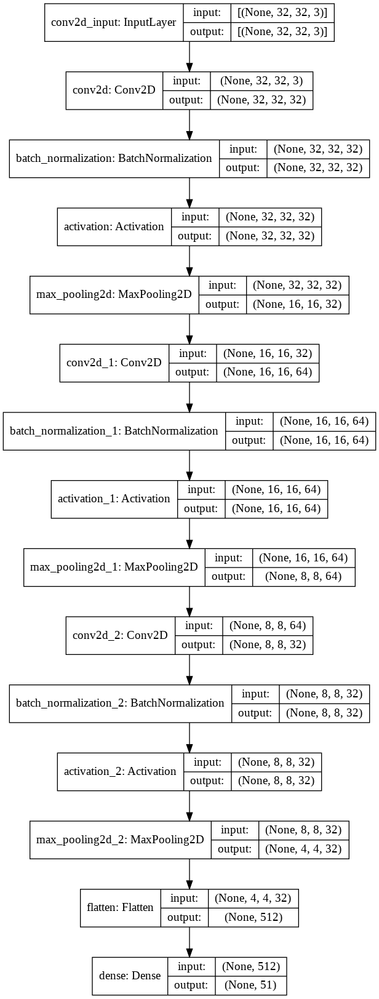

In [ ]:
dot_img_file = '/content/drive/My Drive/Colab Notebooks/CIARP/model_v1.png'
tf.keras.utils.plot_model(model, to_file=dot_img_file, show_shapes=True, rankdir="TB")

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
quantize_model = tfmot.quantization.keras.quantize_model

checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath="best_weights_v5_quantized.hdf5", monitor = 'val_accuracy', verbose=1,  save_best_only=True)

# q_aware stands for for quantization aware.
q_aware_model = quantize_model(model)

# `quantize_model` requires a recompile.
q_aware_model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy', f1_m, precision_m, recall_m])

q_aware_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
quantize_layer (QuantizeLaye (None, 32, 32, 3)         3         
_________________________________________________________________
quant_conv2d (QuantizeWrappe (None, 32, 32, 32)        961       
_________________________________________________________________
quant_batch_normalization (Q (None, 32, 32, 32)        129       
_________________________________________________________________
quant_activation (QuantizeWr (None, 32, 32, 32)        3         
_________________________________________________________________
quant_max_pooling2d (Quantiz (None, 16, 16, 32)        1         
_________________________________________________________________
quant_conv2d_1 (QuantizeWrap (None, 16, 16, 64)        18625     
_________________________________________________________________
quant_batch_normalization_1  (None, 16, 16, 64)        2

In [ ]:
train_images_subset = train_images # out of 20104
train_labels_subset = train_labels

checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath="best_weights_v5_quantized.hdf5", monitor = 'val_accuracy', verbose=1, save_best_only=True)

#it_train, steps_per_epoch=steps, epochs=EPOCHS, validation_data=(test_images, test_labels), callbacks=[tensorboard_callback, cm_callback, checkpointer]
#h = q_aware_model.fit(train_images_subset, train_labels_subset, validation_data=(test_images, test_labels), batch_size=64, epochs=50)
#h = q_aware_model.fit(it_train, steps_per_epoch=steps, epochs=EPOCHS, validation_data=(test_images, test_labels))


q_aware_model.fit(train_images_subset, train_labels_subset, validation_data=(test_images, test_labels),
                  batch_size=64, epochs=25, callbacks=[tensorboard_callback, cm_callback, checkpointer])

Epoch 1/25
189/189 [==============================] - 6s 22ms/step - loss: 4.2652 - accuracy: 0.0180 - f1_m: 0.0000e+00 - precision_m: 0.0000e+00 - recall_m: 0.0000e+00 - val_loss: 4.2652 - val_accuracy: 0.0180 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


(5986,)

Epoch 00001: val_accuracy improved from -inf to 0.01804, saving model to best_weights_v5_quantized.hdf5


RuntimeError: ignored

In [ ]:
q_aware_model.load_weights('best_weights_v5_quantized.hdf5')

converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

open("/content/drive/My Drive/Colab Notebooks/teste_export_model_v5.tflite", "wb").write(tflite_model)

converter = tf.lite.TFLiteConverter.from_keras_model(q_aware_model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
quantized_tflite_model = converter.convert()

open("/content/drive/My Drive/Colab Notebooks/teste_export_model_quantized_v5.tflite", "wb").write(quantized_tflite_model)

#!ls
!xxd -i /content/drive/My\ Drive/Colab\ Notebooks/teste_export_model_v4.tflite > /content/drive/My\ Drive/Colab\ Notebooks/teste_export_model_v5.cc
!xxd -i /content/drive/My\ Drive/Colab\ Notebooks/teste_export_model_quantized_v4.tflite > /content/drive/My\ Drive/Colab\ Notebooks/teste_export_model_quantized_v5.cc



In [ ]:
%tensorboard --logdir logs

Verificando as métricas:

1. Acurácia;
2. Perda;
3. F1-Score;
4. Precisão;
5. Recall;


In [ ]:
path = '/content/drive/My Drive/Colab Notebooks/'

#model = models.load_model('/content/drive/My Drive/Colab Notebooks/shapes_cnn.h5')

#model.compile(loss='categorical_crossentropy',
#              optimizer='rmsprop',
#             metrics=['accuracy'])

#test_loss, test_acc = model.evaluate(test_images,  test_labels, verbose=2)
loss, accuracy, f1_score, precision, recall = model.evaluate(test_images,  test_labels, verbose=0)

print('Test Accuracy', accuracy)
print('Test Loss', loss)
print('Test F1 Score', f1_score)
print('Test Precision', precision)
print('Test Recall', recall)

In [ ]:
#path = '/content/drive/My Drive/Colab Notebooks/'

#model = models.load_model('/content/drive/My Drive/Colab Notebooks/shapes_cnn.h5')

#model.compile(loss='categorical_crossentropy',
#              optimizer='rmsprop',
#              metrics=['accuracy'])


# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = model.evaluate(test_images, test_labels, batch_size=128)
print("test loss, test acc:", results)


#model.compile(optimizer="rmsprop",
#              loss="categorical_crossentropy",
#              metrics=[keras.metrics.Precision(), keras.metrics.Recall()])


def load_batch_2(fpath):
        with open(fpath, 'rb') as f:
            d = pickle.load(f) 

        data = [item[1:] for item in d]
        labels = [item[0] for item in d]
        data = np.asarray(data)
        labels = np.asarray(labels)
        data = data.reshape(data.shape[0], 3, 32, 32)
        return data, labels


prediction_test, y = load_batch_2(os.path.join(path, 'data_batch_test_unseem1'))
prediction_test = prediction_test.transpose(0, 2, 3, 1)

#mean = np.mean(prediction_test, axis=(0,1,2,3))
#std = np.std(prediction_test, axis=(0,1,2,3))
#prediction_test = (prediction_test-mean) / (std + 1e-7)

prediction_test = prediction_test / 255.0
predictions = model.predict_classes(prediction_test)


print('Test Set Samples')
plt.figure(figsize=(10,10))
for i in range(len(prediction_test)):
    plt.subplot(5,7,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    #plt.imshow(prediction_test[i], cmap=plt.cm.binary)
    plt.imshow(prediction_test[i], cmap=plt.cm.binary)
    #plt.xlabel(test_labels[i][0])
    plt.xlabel(predictions[i])



Below we can check another prediction test. Here we insert a Stop sign as an input and the classification takes place correctly. The network reports that the class to which the card belongs is 0 (the original CONTRAN class in documents is 1). There is also an image of one of the intermediate activations of the network, which is useful to understand how successive layers of convolution and their filters act.

In [ ]:
#Predicting unseen images

img_path = '/content/drive/My Drive/Colab Notebooks/test_images/1.png'
img = tf.keras.preprocessing.image.load_img(img_path, target_size=(32, 32))
img_tensor = tf.keras.preprocessing.image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor /= 255
plt.imshow(img_tensor[0])
plt.show()
print(img_tensor.shape)


# predicting images
x = tf.keras.preprocessing.image.img_to_array(img)
x = np.expand_dims(x, axis=0)
images = np.vstack([x])
classes = model.predict_classes(images, batch_size=10)
print("Predicted class is:", classes)

print(model.layers)

layer_outputs = [layer.output for layer in model.layers[:15]] 
activation_model = models.Model(inputs=model.input, outputs=layer_outputs) 

activations = activation_model.predict(img_tensor) 
first_layer_activation = activations[0]

plt.matshow(first_layer_activation[0, :, :, 4], cmap='viridis')


for i in range(len(activations)):
  layer = activations[i]
  plt.matshow(layer[0, :, :, 4], cmap='viridis')

